Dataset contains information of about 40,000 articles published between 2013 and 2015. The dataset is publically available at UCI Machine Learning Repository.( https://archive.ics.uci.edu/ml/machine-learning-databases/00332). The data comes from website https://mashable.com/ .It consists of 39644 rows. Observations are online news articles with 60 features. The goal is to do analysis and modeling to predict number of shares of an article with the given input parameters.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [14]:
data = pd.read_csv("C:\Users\lakshya_hanshvik\Desktop\Datasets/OnlineNewsPopularity.csv")
data.head(5)

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,http://mashable.com/2013/01/07/amazon-instant-...,731.0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,http://mashable.com/2013/01/07/ap-samsung-spon...,731.0,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,http://mashable.com/2013/01/07/apple-40-billio...,731.0,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,http://mashable.com/2013/01/07/astronaut-notre...,731.0,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,http://mashable.com/2013/01/07/att-u-verse-apps/,731.0,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,...,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


Data Features:

Attribute Information:
     0. url:                           URL of the article
     1. timedelta:                     Days between the article publication and
                                       the dataset acquisition
     2. n_tokens_title:                Number of words in the title
     3. n_tokens_content:              Number of words in the content
     4. n_unique_tokens:               Rate of unique words in the content
     5. n_non_stop_words:              Rate of non-stop words in the content
     6. n_non_stop_unique_tokens:      Rate of unique non-stop words in the
                                       content
     7. num_hrefs:                     Number of links
     8. num_self_hrefs:                Number of links to other articles
                                       published by Mashable
     9. num_imgs:                      Number of images
    10. num_videos:                    Number of videos
    11. average_token_length:          Average length of the words in the
                                       content
    12. num_keywords:                  Number of keywords in the metadata
    13. data_channel_is_lifestyle:     Is data channel 'Lifestyle'?
    14. data_channel_is_entertainment: Is data channel 'Entertainment'?
    15. data_channel_is_bus:           Is data channel 'Business'?
    16. data_channel_is_socmed:        Is data channel 'Social Media'?
    17. data_channel_is_tech:          Is data channel 'Tech'?
    18. data_channel_is_world:         Is data channel 'World'?
    19. kw_min_min:                    Worst keyword (min. shares)
    20. kw_max_min:                    Worst keyword (max. shares)
    21. kw_avg_min:                    Worst keyword (avg. shares)
    22. kw_min_max:                    Best keyword (min. shares)
    23. kw_max_max:                    Best keyword (max. shares)
    24. kw_avg_max:                    Best keyword (avg. shares)
    25. kw_min_avg:                    Avg. keyword (min. shares)
    26. kw_max_avg:                    Avg. keyword (max. shares)
    27. kw_avg_avg:                    Avg. keyword (avg. shares)
    28. self_reference_min_shares:     Min. shares of referenced articles in
                                       Mashable
    29. self_reference_max_shares:     Max. shares of referenced articles in
                                       Mashable
    30. self_reference_avg_sharess:    Avg. shares of referenced articles in
                                       Mashable
    31. weekday_is_monday:             Was the article published on a Monday?
    32. weekday_is_tuesday:            Was the article published on a Tuesday?
    33. weekday_is_wednesday:          Was the article published on a Wednesday?
    34. weekday_is_thursday:           Was the article published on a Thursday?
    35. weekday_is_friday:             Was the article published on a Friday?
    36. weekday_is_saturday:           Was the article published on a Saturday?
    37. weekday_is_sunday:             Was the article published on a Sunday?
    38. is_weekend:                    Was the article published on the weekend?
    39. LDA_00:                        Closeness to LDA topic 0
    40. LDA_01:                        Closeness to LDA topic 1
    41. LDA_02:                        Closeness to LDA topic 2
    42. LDA_03:                        Closeness to LDA topic 3
    43. LDA_04:                        Closeness to LDA topic 4
    44. global_subjectivity:           Text subjectivity
    45. global_sentiment_polarity:     Text sentiment polarity
    46. global_rate_positive_words:    Rate of positive words in the content
    47. global_rate_negative_words:    Rate of negative words in the content
    48. rate_positive_words:           Rate of positive words among non-neutral
                                       tokens
    49. rate_negative_words:           Rate of negative words among non-neutral
                                       tokens
    50. avg_positive_polarity:         Avg. polarity of positive words
    51. min_positive_polarity:         Min. polarity of positive words
    52. max_positive_polarity:         Max. polarity of positive words
    53. avg_negative_polarity:         Avg. polarity of negative  words
    54. min_negative_polarity:         Min. polarity of negative  words
    55. max_negative_polarity:         Max. polarity of negative  words
    56. title_subjectivity:            Title subjectivity
    57. title_sentiment_polarity:      Title polarity
    58. abs_title_subjectivity:        Absolute subjectivity level
    59. abs_title_sentiment_polarity:  Absolute polarity level
    60. shares:                        Number of shares (target)

The dataset contains 61 attributes out of which 58 attributes are predictive.The target attribute being the number of 'shares' of that particular article  

In [28]:
#summary of the dataframe ,excluding the null-counts.
print(data.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39644 entries, 0 to 39643
Data columns (total 61 columns):
url                               39644 non-null object
timedelta                         39644 non-null float64
n_tokens_title                    39644 non-null float64
n_tokens_content                  39644 non-null float64
n_unique_tokens                   39644 non-null float64
n_non_stop_words                  39644 non-null float64
n_non_stop_unique_tokens          39644 non-null float64
num_hrefs                         39644 non-null float64
num_self_hrefs                    39644 non-null float64
num_imgs                          39644 non-null float64
num_videos                        39644 non-null float64
average_token_length              39644 non-null float64
num_keywords                      39644 non-null float64
data_channel_is_lifestyle         39644 non-null float64
 data_channel_is_entertainment    39644 non-null float64
data_channel_is_bus               396

Handling Missing Values : 
The UCI machine learning repository which hosts the current data set has indicated that the data set has no missing values

In [48]:
#total number of NULL values across the whole dataset

data.isnull().sum().sum()

0

In [136]:
#From the available 60 attribute , we can drop 
#    URL - Since every URL is unique for each column
data= data.drop(['url'],axis=1)

In [50]:
#Statistical summary of the numerical attributes
#print(data.describe())
for i in list (data.columns):
    print i
    print(data[i].describe())

url
count                                                 39644
unique                                                39644
top       http://mashable.com/2014/04/24/jaguar-marketin...
freq                                                      1
Name: url, dtype: object
timedelta
count    39644.000000
mean       354.530471
std        214.163767
min          8.000000
25%        164.000000
50%        339.000000
75%        542.000000
max        731.000000
Name: timedelta, dtype: float64
n_tokens_title
count    39644.000000
mean        10.398749
std          2.114037
min          2.000000
25%          9.000000
50%         10.000000
75%         12.000000
max         23.000000
Name: n_tokens_title, dtype: float64
n_tokens_content
count    39644.000000
mean       546.514731
std        471.107508
min          0.000000
25%        246.000000
50%        409.000000
75%        716.000000
max       8474.000000
Name: n_tokens_content, dtype: float64
n_unique_tokens
count    39644.000000
mean         0.

count    39644.000000
mean         0.061876
std          0.240933
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
Name: weekday_is_saturday, dtype: float64
weekday_is_sunday
count    39644.000000
mean         0.069039
std          0.253524
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
Name: weekday_is_sunday, dtype: float64
is_weekend
count    39644.000000
mean         0.130915
std          0.337312
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          1.000000
Name: is_weekend, dtype: float64
LDA_00
count    39644.000000
mean         0.184599
std          0.262975
min          0.000000
25%          0.025051
50%          0.033387
75%          0.240958
max          0.926994
Name: LDA_00, dtype: float64
LDA_01
count    39644.000000
mean         0.141256
std          0.219707
min          0.000000
25%          0.025012

count of outliers

In [ ]:
#list of columsn with outliers

for i in list (data.columns):    
        
    dict_stats = dict(data[i].describe())
    Q1 = round(dict_stats['25%'] , 3)
    Q3 = round(dict_stats['75%'] , 3)
    median = round(dict_stats['50%'] , 3)        
    IQR = Q3-Q1
    Lower_threshold = Q1 - 1.5 * IQR
    upper_threshold = Q3 + 1.5 * IQR

    #print('mean =', round(dict_stats['mean'] , 3)),
    #print('std =',round(dict_stats['std'] , 3)),
    #print("median =", median),
    #print("lower quartile =",round(lower_threshold ,3)),
    #print("upper quartile =" ,round(upper_threshold ,3))


    count = 0
    for row  in data[i]:
        if (row < lower_threshold)  or (row > upper_threshold):
            #print(data[data.i==row].index.values.astype(int))
            count += 1
    #if count != 0 : 
        print("no of outliers for {} = {}".format(i,count) )      


no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outliers for timedelta = 0
no of outl

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outliers for n_tokens_title = 0
no of outlie

no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 14
no of outliers for n_tokens_content = 15
no of outliers for n_tokens_content = 15
no of outliers for n_tokens_content = 15
no of outliers for n_tokens_content = 15
no of outliers for n_tokens_content = 15
no of outliers for n_tokens_content = 15
no of outliers for n_tokens_content = 15
no of outliers for n_tokens_content = 15
no of outliers for n_tokens_content = 15
no of outliers for n_tokens_content = 15
no of outliers f

no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers for n_tokens_content = 26
no of outliers f

no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers for n_tokens_content = 34
no of outliers f

no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers for n_tokens_content = 40
no of outliers f

no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers for n_tokens_content = 46
no of outliers f

no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers for n_tokens_content = 54
no of outliers f

no of outliers for n_tokens_content = 69
no of outliers for n_tokens_content = 69
no of outliers for n_tokens_content = 69
no of outliers for n_tokens_content = 69
no of outliers for n_tokens_content = 69
no of outliers for n_tokens_content = 69
no of outliers for n_tokens_content = 69
no of outliers for n_tokens_content = 69
no of outliers for n_tokens_content = 69
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers for n_tokens_content = 70
no of outliers f

no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers for n_tokens_content = 81
no of outliers f

no of outliers for n_tokens_content = 92
no of outliers for n_tokens_content = 92
no of outliers for n_tokens_content = 92
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers for n_tokens_content = 93
no of outliers f

no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_content = 100
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_content = 107
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_content = 115
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_content = 124
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 129
no of outliers for n_tokens_content = 130
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_content = 147
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 161
no of outliers for n_tokens_content = 162
no of outliers for n_tokens_content = 162
no of outliers for n_tokens_content = 162
no of outliers for n_tokens_content = 162
no of outliers for n_tokens_content = 162
no of outliers for n_tokens_content = 162
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_content = 181
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_content = 205
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_content = 223
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_content = 239
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_content = 246
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_content = 278
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 289
no of outliers for n_tokens_content = 289
no of outliers for n_tokens_content = 289
no of outliers for n_tokens_content = 289
no of outliers for n_tokens_content = 289
no of outliers for n_tokens_content = 289
no of outliers for n_tokens_content = 289
no of outliers for n_tokens_content = 289
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_content = 290
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_content = 304
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_content = 314
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_content = 320
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_content = 336
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 350
no of outliers for n_tokens_content = 350
no of outliers for n_tokens_content = 350
no of outliers for n_tokens_content = 350
no of outliers for n_tokens_content = 350
no of outliers for n_tokens_content = 350
no of outliers for n_tokens_content = 351
no of outliers for n_tokens_content = 351
no of outliers for n_tokens_content = 351
no of outliers for n_tokens_content = 351
no of outliers for n_tokens_content = 351
no of outliers for n_tokens_content = 351
no of outliers for n_tokens_content = 351
no of outliers for n_tokens_content = 352
no of outliers for n_tokens_content = 352
no of outliers for n_tokens_content = 352
no of outliers for n_tokens_content = 352
no of outliers for n_tokens_content = 352
no of outliers for n_tokens_content = 352
no of outliers for n_tokens_content = 352
no of outliers for n_tokens_content = 352
no of outliers for n_tokens_content = 352
no of outliers for n_tokens_content = 352
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 364
no of outliers for n_tokens_content = 364
no of outliers for n_tokens_content = 364
no of outliers for n_tokens_content = 364
no of outliers for n_tokens_content = 364
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 365
no of outliers for n_tokens_content = 366
no of outliers for n_tokens_content = 366
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 382
no of outliers for n_tokens_content = 382
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_content = 383
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_content = 400
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_content = 421
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_content = 441
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_content = 473
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_content = 510
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 541
no of outliers for n_tokens_content = 541
no of outliers for n_tokens_content = 541
no of outliers for n_tokens_content = 541
no of outliers for n_tokens_content = 541
no of outliers for n_tokens_content = 541
no of outliers for n_tokens_content = 541
no of outliers for n_tokens_content = 541
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_content = 542
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_content = 572
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_content = 597
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 627
no of outliers for n_tokens_content = 628
no of outliers for n_tokens_content = 628
no of outliers for n_tokens_content = 628
no of outliers for n_tokens_content = 628
no of outliers for n_tokens_content = 628
no of outliers for n_tokens_content = 629
no of outliers for n_tokens_content = 629
no of outliers for n_tokens_content = 629
no of outliers for n_tokens_content = 629
no of outliers for n_tokens_content = 630
no of outliers for n_tokens_content = 630
no of outliers for n_tokens_content = 630
no of outliers for n_tokens_content = 630
no of outliers for n_tokens_content = 630
no of outliers for n_tokens_content = 630
no of outliers for n_tokens_content = 630
no of outliers for n_tokens_content = 631
no of outliers for n_tokens_content = 631
no of outliers for n_tokens_content = 631
no of outliers for n_tokens_content = 631
no of outliers for n_tokens_content = 631
no of outliers for n_tokens_content = 631
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 661
no of outliers for n_tokens_content = 662
no of outliers for n_tokens_content = 663
no of outliers for n_tokens_content = 663
no of outliers for n_tokens_content = 663
no of outliers for n_tokens_content = 663
no of outliers for n_tokens_content = 663
no of outliers for n_tokens_content = 663
no of outliers for n_tokens_content = 663
no of outliers for n_tokens_content = 663
no of outliers for n_tokens_content = 663
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 689
no of outliers for n_tokens_content = 689
no of outliers for n_tokens_content = 689
no of outliers for n_tokens_content = 689
no of outliers for n_tokens_content = 689
no of outliers for n_tokens_content = 689
no of outliers for n_tokens_content = 689
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_content = 690
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_content = 719
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_content = 745
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 777
no of outliers for n_tokens_content = 777
no of outliers for n_tokens_content = 777
no of outliers for n_tokens_content = 777
no of outliers for n_tokens_content = 777
no of outliers for n_tokens_content = 777
no of outliers for n_tokens_content = 777
no of outliers for n_tokens_content = 777
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_content = 778
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_content = 813
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_content = 843
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_content = 874
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_content = 901
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_content = 928
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_content = 957
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 981
no of outliers for n_tokens_content = 981
no of outliers for n_tokens_content = 981
no of outliers for n_tokens_content = 981
no of outliers for n_tokens_content = 981
no of outliers for n_tokens_content = 981
no of outliers for n_tokens_content = 981
no of outliers for n_tokens_content = 981
no of outliers for n_tokens_content = 981
no of outliers for n_tokens_content = 981
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 982
no of outliers for n_tokens_content = 983
no of outliers for n_tokens_conten

no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outliers for n_tokens_content = 1011
no of outli

no of outliers for n_tokens_content = 1024
no of outliers for n_tokens_content = 1024
no of outliers for n_tokens_content = 1024
no of outliers for n_tokens_content = 1024
no of outliers for n_tokens_content = 1024
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outliers for n_tokens_content = 1025
no of outli

no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_unique_tokens = 1
no of outliers for n_uniq

no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_unique_tokens = 7
no of outliers for n_uniq

no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_unique_tokens = 9
no of outliers for n_uniq

no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23
no of outliers for n_unique_tokens = 23


no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32
no of outliers for n_unique_tokens = 32


no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40
no of outliers for n_unique_tokens = 40


no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44
no of outliers for n_unique_tokens = 44


no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51
no of outliers for n_unique_tokens = 51


no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63
no of outliers for n_unique_tokens = 63


no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74
no of outliers for n_unique_tokens = 74


no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80
no of outliers for n_unique_tokens = 80


no of outliers for n_unique_tokens = 90
no of outliers for n_unique_tokens = 90
no of outliers for n_unique_tokens = 90
no of outliers for n_unique_tokens = 90
no of outliers for n_unique_tokens = 90
no of outliers for n_unique_tokens = 90
no of outliers for n_unique_tokens = 90
no of outliers for n_unique_tokens = 90
no of outliers for n_unique_tokens = 90
no of outliers for n_unique_tokens = 90
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91
no of outliers for n_unique_tokens = 91


no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 98
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99
no of outliers for n_unique_tokens = 99


no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers for n_unique_tokens = 107
no of outliers f

no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers for n_unique_tokens = 120
no of outliers f

no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 124
no of outliers for n_unique_tokens = 125
no of outliers for n_unique_tokens = 125
no of outliers for n_unique_tokens = 125
no of outliers for n_unique_tokens = 125
no of outliers for n_unique_tokens = 125
no of outliers f

no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers for n_unique_tokens = 127
no of outliers f

no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers for n_unique_tokens = 131
no of outliers f

no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers f

no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers for n_unique_tokens = 132
no of outliers f

no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers for n_unique_tokens = 133
no of outliers f

no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers for n_unique_tokens = 135
no of outliers f

no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 139
no of outliers for n_unique_tokens = 140
no of outliers for n_unique_tokens = 140
no of outliers for n_unique_tokens = 140
no of outliers for n_unique_tokens = 140
no of outliers for n_unique_tokens = 140
no of outliers for n_unique_tokens = 140
no of outliers f

no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 141
no of outliers for n_unique_tokens = 142
no of outliers for n_unique_tokens = 142
no of outliers f

no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers for n_unique_tokens = 144
no of outliers f

no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers f

no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers for n_unique_tokens = 146
no of outliers f

no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers for n_unique_tokens = 149
no of outliers f

no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers for n_unique_tokens = 151
no of outliers f

no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers for n_unique_tokens = 153
no of outliers f

no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers for n_unique_tokens = 156
no of outliers f

no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers for n_unique_tokens = 159
no of outliers f

no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers for n_unique_tokens = 161
no of outliers f

no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers for n_unique_tokens = 164
no of outliers f

no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers for n_unique_tokens = 168
no of outliers f

no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers for n_unique_tokens = 173
no of outliers f

no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers for n_unique_tokens = 177
no of outliers f

no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers for n_unique_tokens = 178
no of outliers f

no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers for n_unique_tokens = 180
no of outliers f

no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers for n_unique_tokens = 186
no of outliers f

no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 187
no of outliers for n_unique_tokens = 188
no of outliers for n_unique_tokens = 188
no of outliers for n_unique_tokens = 188
no of outliers for n_unique_tokens = 188
no of outliers for n_unique_tokens = 188
no of outliers for n_unique_tokens = 188
no of outliers for n_unique_tokens = 188
no of outliers for n_unique_tokens = 188
no of outliers for n_unique_tokens = 188
no of outliers for n_unique_tokens = 188
no of outliers for n_unique_tokens = 188
no of outliers f

no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers for n_unique_tokens = 189
no of outliers f

no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers for n_unique_tokens = 190
no of outliers f

no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers for n_unique_tokens = 192
no of outliers f

no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers for n_unique_tokens = 194
no of outliers f

no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers for n_unique_tokens = 195
no of outliers f

no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0
no of outliers for n_non_stop_words = 0


no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n_non_stop_unique_tokens = 13
no of outliers for n

no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n_non_stop_unique_tokens = 32
no of outliers for n

no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n_non_stop_unique_tokens = 38
no of outliers for n

no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n_non_stop_unique_tokens = 50
no of outliers for n

no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n_non_stop_unique_tokens = 59
no of outliers for n

no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n_non_stop_unique_tokens = 75
no of outliers for n

no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n_non_stop_unique_tokens = 87
no of outliers for n

no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n_non_stop_unique_tokens = 95
no of outliers for n

no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104
no of outliers for n_non_stop_unique_tokens = 104


no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113
no of outliers for n_non_stop_unique_tokens = 113


no of outliers for n_non_stop_unique_tokens = 120
no of outliers for n_non_stop_unique_tokens = 120
no of outliers for n_non_stop_unique_tokens = 120
no of outliers for n_non_stop_unique_tokens = 120
no of outliers for n_non_stop_unique_tokens = 120
no of outliers for n_non_stop_unique_tokens = 120
no of outliers for n_non_stop_unique_tokens = 120
no of outliers for n_non_stop_unique_tokens = 120
no of outliers for n_non_stop_unique_tokens = 120
no of outliers for n_non_stop_unique_tokens = 120
no of outliers for n_non_stop_unique_tokens = 121
no of outliers for n_non_stop_unique_tokens = 121
no of outliers for n_non_stop_unique_tokens = 121
no of outliers for n_non_stop_unique_tokens = 121
no of outliers for n_non_stop_unique_tokens = 121
no of outliers for n_non_stop_unique_tokens = 121
no of outliers for n_non_stop_unique_tokens = 121
no of outliers for n_non_stop_unique_tokens = 121
no of outliers for n_non_stop_unique_tokens = 121
no of outliers for n_non_stop_unique_tokens = 121


no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127
no of outliers for n_non_stop_unique_tokens = 127


no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138
no of outliers for n_non_stop_unique_tokens = 138


no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145
no of outliers for n_non_stop_unique_tokens = 145


no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148
no of outliers for n_non_stop_unique_tokens = 148


no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151
no of outliers for n_non_stop_unique_tokens = 151


no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154
no of outliers for n_non_stop_unique_tokens = 154


no of outliers for n_non_stop_unique_tokens = 163
no of outliers for n_non_stop_unique_tokens = 163
no of outliers for n_non_stop_unique_tokens = 163
no of outliers for n_non_stop_unique_tokens = 163
no of outliers for n_non_stop_unique_tokens = 163
no of outliers for n_non_stop_unique_tokens = 163
no of outliers for n_non_stop_unique_tokens = 163
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164
no of outliers for n_non_stop_unique_tokens = 164


no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166
no of outliers for n_non_stop_unique_tokens = 166


no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168
no of outliers for n_non_stop_unique_tokens = 168


no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175
no of outliers for n_non_stop_unique_tokens = 175


no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 181
no of outliers for n_non_stop_unique_tokens = 182
no of outliers for n_non_stop_unique_tokens = 182


no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188
no of outliers for n_non_stop_unique_tokens = 188


no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191
no of outliers for n_non_stop_unique_tokens = 191


no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193
no of outliers for n_non_stop_unique_tokens = 193


no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196
no of outliers for n_non_stop_unique_tokens = 196


no of outliers for num_hrefs = 7
no of outliers for num_hrefs = 7
no of outliers for num_hrefs = 7
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 8
no of outliers for num_hrefs = 9
no of outliers for num_hrefs = 9
no of outliers for num_hrefs = 9
no of outliers for num_hrefs = 9
no of outliers for num_hrefs = 9
no of outliers for num_hrefs = 9
no of outliers for num_hrefs = 9
no of outliers for num_hrefs = 9
no of outliers for num_hrefs = 9
no of outliers for num_hrefs = 9
no of outl

no of outliers for num_hrefs = 34
no of outliers for num_hrefs = 34
no of outliers for num_hrefs = 34
no of outliers for num_hrefs = 34
no of outliers for num_hrefs = 34
no of outliers for num_hrefs = 34
no of outliers for num_hrefs = 34
no of outliers for num_hrefs = 34
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers for num_hrefs = 35
no of outliers

no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers for num_hrefs = 78
no of outliers

no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 115
no of outliers for num_hrefs = 116
no of outliers for num_hrefs = 117
no of outliers for num_hrefs = 117
no of outliers for num_hrefs = 117
no of outliers for num_hrefs = 117
no of outliers for n

no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for num_hrefs = 145
no of outliers for n

no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for num_hrefs = 174
no of outliers for n

no of outliers for num_hrefs = 219
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 220
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for num_hrefs = 221
no of outliers for n

no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 279
no of outliers for num_hrefs = 280
no of outliers for num_hrefs = 280
no of outliers for num_hrefs = 280
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 281
no of outliers for num_hrefs = 282
no of outliers for num_hrefs = 282
no of outliers for num_hrefs = 282
no of outliers for n

no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for num_hrefs = 328
no of outliers for n

no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 371
no of outliers for num_hrefs = 372
no of outliers for num_hrefs = 373
no of outliers for num_hrefs = 373
no of outliers for num_hrefs = 373
no of outliers for num_hrefs = 373
no of outliers for num_hrefs = 373
no of outliers for num_hrefs = 373
no of outliers for num_hrefs = 373
no of outliers for num_hrefs = 373
no of outliers for num_hrefs = 373
no of outliers for num_hrefs = 373
no of outliers for num_hrefs = 373
no of outliers for n

no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for num_hrefs = 448
no of outliers for n

no of outliers for num_hrefs = 502
no of outliers for num_hrefs = 502
no of outliers for num_hrefs = 502
no of outliers for num_hrefs = 502
no of outliers for num_hrefs = 502
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 503
no of outliers for num_hrefs = 504
no of outliers for num_hrefs = 504
no of outliers for num_hrefs = 504
no of outliers for num_hrefs = 504
no of outliers for num_hrefs = 504
no of outliers for num_hrefs = 504
no of outliers for num_hrefs = 504
no of outliers for n

no of outliers for num_hrefs = 592
no of outliers for num_hrefs = 592
no of outliers for num_hrefs = 592
no of outliers for num_hrefs = 592
no of outliers for num_hrefs = 593
no of outliers for num_hrefs = 593
no of outliers for num_hrefs = 593
no of outliers for num_hrefs = 593
no of outliers for num_hrefs = 594
no of outliers for num_hrefs = 594
no of outliers for num_hrefs = 594
no of outliers for num_hrefs = 594
no of outliers for num_hrefs = 594
no of outliers for num_hrefs = 594
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 595
no of outliers for num_hrefs = 596
no of outliers for num_hrefs = 596
no of outliers for num_hrefs = 596
no of outliers for n

no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 656
no of outliers for num_hrefs = 657
no of outliers for num_hrefs = 657
no of outliers for num_hrefs = 657
no of outliers for num_hrefs = 657
no of outliers for n

no of outliers for num_hrefs = 720
no of outliers for num_hrefs = 720
no of outliers for num_hrefs = 720
no of outliers for num_hrefs = 720
no of outliers for num_hrefs = 720
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 721
no of outliers for num_hrefs = 722
no of outliers for num_hrefs = 722
no of outliers for num_hrefs = 722
no of outliers for num_hrefs = 722
no of outliers for num_hrefs = 722
no of outliers for num_hrefs = 722
no of outliers for num_hrefs = 722
no of outliers for num_hrefs = 722
no of outliers for n

no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for num_hrefs = 777
no of outliers for n

no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for num_hrefs = 829
no of outliers for n

no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for num_hrefs = 853
no of outliers for n

no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for num_hrefs = 869
no of outliers for n

no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 886
no of outliers for num_hrefs = 887
no of outliers for num_hrefs = 887
no of outliers for num_hrefs = 887
no of outliers for num_hrefs = 887
no of outliers for n

no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for num_hrefs = 907
no of outliers for n

no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for num_hrefs = 934
no of outliers for n

no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 955
no of outliers for num_hrefs = 956
no of outliers for num_hrefs = 956
no of outliers for n

no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for num_hrefs = 969
no of outliers for n

no of outliers for num_hrefs = 998
no of outliers for num_hrefs = 998
no of outliers for num_hrefs = 998
no of outliers for num_hrefs = 998
no of outliers for num_hrefs = 998
no of outliers for num_hrefs = 998
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for num_hrefs = 999
no of outliers for n

no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs = 1025
no of outliers for num_hrefs

no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs = 1043
no of outliers for num_hrefs

no of outliers for num_hrefs = 1077
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs = 1078
no of outliers for num_hrefs

no of outliers for num_hrefs = 1102
no of outliers for num_hrefs = 1102
no of outliers for num_hrefs = 1103
no of outliers for num_hrefs = 1103
no of outliers for num_hrefs = 1103
no of outliers for num_hrefs = 1103
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1104
no of outliers for num_hrefs = 1105
no of outliers for num_hrefs = 1105
no of outliers for num_hrefs

no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs = 1133
no of outliers for num_hrefs

no of outliers for num_hrefs = 1163
no of outliers for num_hrefs = 1163
no of outliers for num_hrefs = 1163
no of outliers for num_hrefs = 1163
no of outliers for num_hrefs = 1163
no of outliers for num_hrefs = 1163
no of outliers for num_hrefs = 1163
no of outliers for num_hrefs = 1163
no of outliers for num_hrefs = 1163
no of outliers for num_hrefs = 1163
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs = 1164
no of outliers for num_hrefs

no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1187
no of outliers for num_hrefs = 1188
no of outliers for num_hrefs = 1188
no of outliers for num_hrefs = 1188
no of outliers for num_hrefs = 1188
no of outliers for num_hrefs = 1188
no of outliers for num_hrefs = 1189
no of outliers for num_hrefs = 1189
no of outliers for num_hrefs

no of outliers for num_hrefs = 1225
no of outliers for num_hrefs = 1225
no of outliers for num_hrefs = 1225
no of outliers for num_hrefs = 1225
no of outliers for num_hrefs = 1225
no of outliers for num_hrefs = 1225
no of outliers for num_hrefs = 1225
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs = 1226
no of outliers for num_hrefs

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outliers for num_self_hrefs = 0
no of outlie

no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outliers for num_imgs = 14
no of outl

no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 52
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outliers for num_imgs = 53
no of outl

no of outliers for num_imgs = 95
no of outliers for num_imgs = 95
no of outliers for num_imgs = 96
no of outliers for num_imgs = 97
no of outliers for num_imgs = 97
no of outliers for num_imgs = 97
no of outliers for num_imgs = 97
no of outliers for num_imgs = 98
no of outliers for num_imgs = 98
no of outliers for num_imgs = 98
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 99
no of outliers for num_imgs = 100
no of outliers for num_imgs = 100
no of outliers for num_imgs = 100
no of outliers for num_imgs = 100
no of outliers for num_imgs = 100
no of outliers for num_imgs = 100
no o

no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers for num_imgs = 147
no of outliers

no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 162
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers for num_imgs = 163
no of outliers

no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers for num_imgs = 187
no of outliers

no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers for num_imgs = 214
no of outliers

no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers for num_imgs = 249
no of outliers

no of outliers for num_imgs = 275
no of outliers for num_imgs = 275
no of outliers for num_imgs = 275
no of outliers for num_imgs = 275
no of outliers for num_imgs = 275
no of outliers for num_imgs = 275
no of outliers for num_imgs = 275
no of outliers for num_imgs = 275
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers for num_imgs = 276
no of outliers

no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 286
no of outliers for num_imgs = 287
no of outliers for num_imgs = 287
no of outliers for num_imgs = 287
no of outliers for num_imgs = 287
no of outliers

no of outliers for num_imgs = 318
no of outliers for num_imgs = 318
no of outliers for num_imgs = 318
no of outliers for num_imgs = 318
no of outliers for num_imgs = 318
no of outliers for num_imgs = 318
no of outliers for num_imgs = 318
no of outliers for num_imgs = 318
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers for num_imgs = 319
no of outliers

no of outliers for num_imgs = 355
no of outliers for num_imgs = 355
no of outliers for num_imgs = 355
no of outliers for num_imgs = 355
no of outliers for num_imgs = 355
no of outliers for num_imgs = 355
no of outliers for num_imgs = 355
no of outliers for num_imgs = 355
no of outliers for num_imgs = 355
no of outliers for num_imgs = 355
no of outliers for num_imgs = 355
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers for num_imgs = 356
no of outliers

no of outliers for num_imgs = 371
no of outliers for num_imgs = 371
no of outliers for num_imgs = 371
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers for num_imgs = 372
no of outliers

no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers for num_imgs = 387
no of outliers

no of outliers for num_imgs = 430
no of outliers for num_imgs = 430
no of outliers for num_imgs = 430
no of outliers for num_imgs = 430
no of outliers for num_imgs = 430
no of outliers for num_imgs = 430
no of outliers for num_imgs = 430
no of outliers for num_imgs = 430
no of outliers for num_imgs = 430
no of outliers for num_imgs = 430
no of outliers for num_imgs = 431
no of outliers for num_imgs = 431
no of outliers for num_imgs = 431
no of outliers for num_imgs = 431
no of outliers for num_imgs = 431
no of outliers for num_imgs = 432
no of outliers for num_imgs = 432
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers for num_imgs = 433
no of outliers

no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 484
no of outliers for num_imgs = 485
no of outliers for num_imgs = 485
no of outliers for num_imgs = 485
no of outliers for num_imgs = 485
no of outliers for num_imgs = 485
no of outliers for num_imgs = 486
no of outliers for num_imgs = 486
no of outliers for num_imgs = 486
no of outliers for num_imgs = 486
no of outliers for num_imgs = 486
no of outliers for num_imgs = 486
no of outliers for num_imgs = 486
no of outliers for num_imgs = 486
no of outliers for num_imgs = 486
no of outliers for num_imgs = 486
no of outliers

no of outliers for num_imgs = 536
no of outliers for num_imgs = 536
no of outliers for num_imgs = 536
no of outliers for num_imgs = 536
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers for num_imgs = 537
no of outliers

no of outliers for num_imgs = 569
no of outliers for num_imgs = 569
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 570
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers for num_imgs = 571
no of outliers

no of outliers for num_imgs = 628
no of outliers for num_imgs = 628
no of outliers for num_imgs = 628
no of outliers for num_imgs = 628
no of outliers for num_imgs = 628
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 629
no of outliers for num_imgs = 630
no of outliers for num_imgs = 630
no of outliers for num_imgs = 630
no of outliers for num_imgs = 630
no of outliers for num_imgs = 630
no of outliers for num_imgs = 630
no of outliers for num_imgs = 630
no of outliers

no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 669
no of outliers for num_imgs = 670
no of outliers for num_imgs = 670
no of outliers for num_imgs = 670
no of outliers

no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 714
no of outliers for num_imgs = 715
no of outliers for num_imgs = 716
no of outliers for num_imgs = 716
no of outliers for num_imgs = 716
no of outliers for num_imgs = 716
no of outliers for num_imgs = 716
no of outliers for num_imgs = 716
no of outliers for num_imgs = 716
no of outliers for num_imgs = 716
no of outliers for num_imgs = 716
no of outliers for num_imgs = 717
no of outliers for num_imgs = 717
no of outliers for num_imgs = 717
no of outliers for num_imgs = 717
no of outliers for num_imgs = 717
no of outliers for num_imgs = 717
no of outliers for num_imgs = 717
no of outliers

no of outliers for num_imgs = 828
no of outliers for num_imgs = 828
no of outliers for num_imgs = 828
no of outliers for num_imgs = 828
no of outliers for num_imgs = 829
no of outliers for num_imgs = 829
no of outliers for num_imgs = 830
no of outliers for num_imgs = 830
no of outliers for num_imgs = 830
no of outliers for num_imgs = 830
no of outliers for num_imgs = 830
no of outliers for num_imgs = 830
no of outliers for num_imgs = 831
no of outliers for num_imgs = 832
no of outliers for num_imgs = 833
no of outliers for num_imgs = 833
no of outliers for num_imgs = 833
no of outliers for num_imgs = 833
no of outliers for num_imgs = 834
no of outliers for num_imgs = 835
no of outliers for num_imgs = 835
no of outliers for num_imgs = 835
no of outliers for num_imgs = 835
no of outliers for num_imgs = 835
no of outliers for num_imgs = 835
no of outliers for num_imgs = 835
no of outliers for num_imgs = 835
no of outliers for num_imgs = 835
no of outliers for num_imgs = 835
no of outliers

no of outliers for num_imgs = 1039
no of outliers for num_imgs = 1039
no of outliers for num_imgs = 1039
no of outliers for num_imgs = 1039
no of outliers for num_imgs = 1040
no of outliers for num_imgs = 1040
no of outliers for num_imgs = 1040
no of outliers for num_imgs = 1040
no of outliers for num_imgs = 1041
no of outliers for num_imgs = 1041
no of outliers for num_imgs = 1041
no of outliers for num_imgs = 1041
no of outliers for num_imgs = 1042
no of outliers for num_imgs = 1043
no of outliers for num_imgs = 1044
no of outliers for num_imgs = 1044
no of outliers for num_imgs = 1045
no of outliers for num_imgs = 1045
no of outliers for num_imgs = 1045
no of outliers for num_imgs = 1046
no of outliers for num_imgs = 1047
no of outliers for num_imgs = 1048
no of outliers for num_imgs = 1048
no of outliers for num_imgs = 1049
no of outliers for num_imgs = 1049
no of outliers for num_imgs = 1049
no of outliers for num_imgs = 1049
no of outliers for num_imgs = 1050
no of outliers for n

no of outliers for num_imgs = 1278
no of outliers for num_imgs = 1278
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1279
no of outliers for num_imgs = 1280
no of outliers for num_imgs = 1280
no of outliers for num_imgs = 1280
no of outliers for num_imgs = 1280
no of outliers for num_imgs = 1280
no of outliers for num_imgs = 1280
no of outliers for num_imgs = 1281
no of outliers for num_imgs = 1281
no of outliers for num_imgs = 1281
no of outliers for num_imgs = 1281
no of outliers for num_imgs = 1281
no of outliers for num_imgs = 1281
no of outliers for num_imgs = 1281
no of outliers for num_imgs = 1281
no of outliers for num_imgs = 1281
no of outliers for n

no of outliers for num_imgs = 1554
no of outliers for num_imgs = 1554
no of outliers for num_imgs = 1555
no of outliers for num_imgs = 1556
no of outliers for num_imgs = 1557
no of outliers for num_imgs = 1557
no of outliers for num_imgs = 1557
no of outliers for num_imgs = 1558
no of outliers for num_imgs = 1558
no of outliers for num_imgs = 1558
no of outliers for num_imgs = 1558
no of outliers for num_imgs = 1558
no of outliers for num_imgs = 1558
no of outliers for num_imgs = 1559
no of outliers for num_imgs = 1559
no of outliers for num_imgs = 1559
no of outliers for num_imgs = 1560
no of outliers for num_imgs = 1561
no of outliers for num_imgs = 1561
no of outliers for num_imgs = 1561
no of outliers for num_imgs = 1561
no of outliers for num_imgs = 1562
no of outliers for num_imgs = 1562
no of outliers for num_imgs = 1563
no of outliers for num_imgs = 1564
no of outliers for num_imgs = 1564
no of outliers for num_imgs = 1564
no of outliers for num_imgs = 1565
no of outliers for n

no of outliers for num_imgs = 1816
no of outliers for num_imgs = 1817
no of outliers for num_imgs = 1818
no of outliers for num_imgs = 1819
no of outliers for num_imgs = 1819
no of outliers for num_imgs = 1819
no of outliers for num_imgs = 1819
no of outliers for num_imgs = 1819
no of outliers for num_imgs = 1819
no of outliers for num_imgs = 1819
no of outliers for num_imgs = 1820
no of outliers for num_imgs = 1821
no of outliers for num_imgs = 1821
no of outliers for num_imgs = 1822
no of outliers for num_imgs = 1822
no of outliers for num_imgs = 1822
no of outliers for num_imgs = 1822
no of outliers for num_imgs = 1823
no of outliers for num_imgs = 1823
no of outliers for num_imgs = 1823
no of outliers for num_imgs = 1823
no of outliers for num_imgs = 1824
no of outliers for num_imgs = 1825
no of outliers for num_imgs = 1825
no of outliers for num_imgs = 1825
no of outliers for num_imgs = 1825
no of outliers for num_imgs = 1825
no of outliers for num_imgs = 1826
no of outliers for n

no of outliers for num_imgs = 2240
no of outliers for num_imgs = 2240
no of outliers for num_imgs = 2240
no of outliers for num_imgs = 2240
no of outliers for num_imgs = 2240
no of outliers for num_imgs = 2240
no of outliers for num_imgs = 2241
no of outliers for num_imgs = 2242
no of outliers for num_imgs = 2243
no of outliers for num_imgs = 2244
no of outliers for num_imgs = 2244
no of outliers for num_imgs = 2245
no of outliers for num_imgs = 2245
no of outliers for num_imgs = 2245
no of outliers for num_imgs = 2245
no of outliers for num_imgs = 2246
no of outliers for num_imgs = 2247
no of outliers for num_imgs = 2248
no of outliers for num_imgs = 2249
no of outliers for num_imgs = 2250
no of outliers for num_imgs = 2250
no of outliers for num_imgs = 2251
no of outliers for num_imgs = 2251
no of outliers for num_imgs = 2252
no of outliers for num_imgs = 2252
no of outliers for num_imgs = 2252
no of outliers for num_imgs = 2252
no of outliers for num_imgs = 2252
no of outliers for n

no of outliers for num_imgs = 2555
no of outliers for num_imgs = 2556
no of outliers for num_imgs = 2556
no of outliers for num_imgs = 2556
no of outliers for num_imgs = 2556
no of outliers for num_imgs = 2556
no of outliers for num_imgs = 2556
no of outliers for num_imgs = 2556
no of outliers for num_imgs = 2557
no of outliers for num_imgs = 2557
no of outliers for num_imgs = 2557
no of outliers for num_imgs = 2557
no of outliers for num_imgs = 2557
no of outliers for num_imgs = 2557
no of outliers for num_imgs = 2558
no of outliers for num_imgs = 2558
no of outliers for num_imgs = 2559
no of outliers for num_imgs = 2559
no of outliers for num_imgs = 2559
no of outliers for num_imgs = 2559
no of outliers for num_imgs = 2559
no of outliers for num_imgs = 2559
no of outliers for num_imgs = 2560
no of outliers for num_imgs = 2560
no of outliers for num_imgs = 2560
no of outliers for num_imgs = 2560
no of outliers for num_imgs = 2560
no of outliers for num_imgs = 2560
no of outliers for n

no of outliers for num_imgs = 2873
no of outliers for num_imgs = 2873
no of outliers for num_imgs = 2873
no of outliers for num_imgs = 2874
no of outliers for num_imgs = 2874
no of outliers for num_imgs = 2875
no of outliers for num_imgs = 2875
no of outliers for num_imgs = 2875
no of outliers for num_imgs = 2876
no of outliers for num_imgs = 2877
no of outliers for num_imgs = 2877
no of outliers for num_imgs = 2877
no of outliers for num_imgs = 2877
no of outliers for num_imgs = 2877
no of outliers for num_imgs = 2877
no of outliers for num_imgs = 2878
no of outliers for num_imgs = 2879
no of outliers for num_imgs = 2879
no of outliers for num_imgs = 2879
no of outliers for num_imgs = 2879
no of outliers for num_imgs = 2880
no of outliers for num_imgs = 2880
no of outliers for num_imgs = 2880
no of outliers for num_imgs = 2880
no of outliers for num_imgs = 2881
no of outliers for num_imgs = 2881
no of outliers for num_imgs = 2881
no of outliers for num_imgs = 2881
no of outliers for n

no of outliers for num_imgs = 3194
no of outliers for num_imgs = 3194
no of outliers for num_imgs = 3194
no of outliers for num_imgs = 3194
no of outliers for num_imgs = 3195
no of outliers for num_imgs = 3196
no of outliers for num_imgs = 3196
no of outliers for num_imgs = 3196
no of outliers for num_imgs = 3196
no of outliers for num_imgs = 3196
no of outliers for num_imgs = 3196
no of outliers for num_imgs = 3196
no of outliers for num_imgs = 3197
no of outliers for num_imgs = 3197
no of outliers for num_imgs = 3197
no of outliers for num_imgs = 3197
no of outliers for num_imgs = 3197
no of outliers for num_imgs = 3197
no of outliers for num_imgs = 3197
no of outliers for num_imgs = 3197
no of outliers for num_imgs = 3198
no of outliers for num_imgs = 3198
no of outliers for num_imgs = 3198
no of outliers for num_imgs = 3198
no of outliers for num_imgs = 3198
no of outliers for num_imgs = 3198
no of outliers for num_imgs = 3198
no of outliers for num_imgs = 3199
no of outliers for n

no of outliers for num_imgs = 3499
no of outliers for num_imgs = 3499
no of outliers for num_imgs = 3499
no of outliers for num_imgs = 3499
no of outliers for num_imgs = 3500
no of outliers for num_imgs = 3500
no of outliers for num_imgs = 3500
no of outliers for num_imgs = 3500
no of outliers for num_imgs = 3501
no of outliers for num_imgs = 3501
no of outliers for num_imgs = 3501
no of outliers for num_imgs = 3501
no of outliers for num_imgs = 3501
no of outliers for num_imgs = 3501
no of outliers for num_imgs = 3501
no of outliers for num_imgs = 3502
no of outliers for num_imgs = 3502
no of outliers for num_imgs = 3502
no of outliers for num_imgs = 3502
no of outliers for num_imgs = 3503
no of outliers for num_imgs = 3503
no of outliers for num_imgs = 3503
no of outliers for num_imgs = 3503
no of outliers for num_imgs = 3503
no of outliers for num_imgs = 3503
no of outliers for num_imgs = 3504
no of outliers for num_imgs = 3504
no of outliers for num_imgs = 3505
no of outliers for n

no of outliers for num_imgs = 3836
no of outliers for num_imgs = 3836
no of outliers for num_imgs = 3836
no of outliers for num_imgs = 3836
no of outliers for num_imgs = 3836
no of outliers for num_imgs = 3837
no of outliers for num_imgs = 3837
no of outliers for num_imgs = 3838
no of outliers for num_imgs = 3838
no of outliers for num_imgs = 3838
no of outliers for num_imgs = 3838
no of outliers for num_imgs = 3839
no of outliers for num_imgs = 3840
no of outliers for num_imgs = 3840
no of outliers for num_imgs = 3841
no of outliers for num_imgs = 3841
no of outliers for num_imgs = 3841
no of outliers for num_imgs = 3842
no of outliers for num_imgs = 3842
no of outliers for num_imgs = 3842
no of outliers for num_imgs = 3842
no of outliers for num_imgs = 3842
no of outliers for num_imgs = 3843
no of outliers for num_imgs = 3843
no of outliers for num_imgs = 3844
no of outliers for num_imgs = 3844
no of outliers for num_imgs = 3845
no of outliers for num_imgs = 3846
no of outliers for n

no of outliers for num_imgs = 4155
no of outliers for num_imgs = 4155
no of outliers for num_imgs = 4155
no of outliers for num_imgs = 4155
no of outliers for num_imgs = 4156
no of outliers for num_imgs = 4156
no of outliers for num_imgs = 4157
no of outliers for num_imgs = 4157
no of outliers for num_imgs = 4157
no of outliers for num_imgs = 4157
no of outliers for num_imgs = 4157
no of outliers for num_imgs = 4157
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4158
no of outliers for num_imgs = 4159
no of outliers for n

no of outliers for num_imgs = 4435
no of outliers for num_imgs = 4435
no of outliers for num_imgs = 4435
no of outliers for num_imgs = 4435
no of outliers for num_imgs = 4435
no of outliers for num_imgs = 4435
no of outliers for num_imgs = 4436
no of outliers for num_imgs = 4436
no of outliers for num_imgs = 4436
no of outliers for num_imgs = 4436
no of outliers for num_imgs = 4436
no of outliers for num_imgs = 4436
no of outliers for num_imgs = 4437
no of outliers for num_imgs = 4437
no of outliers for num_imgs = 4437
no of outliers for num_imgs = 4437
no of outliers for num_imgs = 4437
no of outliers for num_imgs = 4437
no of outliers for num_imgs = 4438
no of outliers for num_imgs = 4439
no of outliers for num_imgs = 4439
no of outliers for num_imgs = 4439
no of outliers for num_imgs = 4439
no of outliers for num_imgs = 4439
no of outliers for num_imgs = 4440
no of outliers for num_imgs = 4441
no of outliers for num_imgs = 4441
no of outliers for num_imgs = 4442
no of outliers for n

no of outliers for num_imgs = 4880
no of outliers for num_imgs = 4880
no of outliers for num_imgs = 4880
no of outliers for num_imgs = 4880
no of outliers for num_imgs = 4880
no of outliers for num_imgs = 4881
no of outliers for num_imgs = 4881
no of outliers for num_imgs = 4881
no of outliers for num_imgs = 4881
no of outliers for num_imgs = 4881
no of outliers for num_imgs = 4882
no of outliers for num_imgs = 4882
no of outliers for num_imgs = 4882
no of outliers for num_imgs = 4883
no of outliers for num_imgs = 4884
no of outliers for num_imgs = 4884
no of outliers for num_imgs = 4884
no of outliers for num_imgs = 4885
no of outliers for num_imgs = 4886
no of outliers for num_imgs = 4887
no of outliers for num_imgs = 4888
no of outliers for num_imgs = 4888
no of outliers for num_imgs = 4888
no of outliers for num_imgs = 4888
no of outliers for num_imgs = 4888
no of outliers for num_imgs = 4888
no of outliers for num_imgs = 4888
no of outliers for num_imgs = 4889
no of outliers for n

no of outliers for num_imgs = 5172
no of outliers for num_imgs = 5173
no of outliers for num_imgs = 5173
no of outliers for num_imgs = 5173
no of outliers for num_imgs = 5174
no of outliers for num_imgs = 5174
no of outliers for num_imgs = 5175
no of outliers for num_imgs = 5175
no of outliers for num_imgs = 5176
no of outliers for num_imgs = 5176
no of outliers for num_imgs = 5176
no of outliers for num_imgs = 5176
no of outliers for num_imgs = 5176
no of outliers for num_imgs = 5176
no of outliers for num_imgs = 5176
no of outliers for num_imgs = 5176
no of outliers for num_imgs = 5177
no of outliers for num_imgs = 5177
no of outliers for num_imgs = 5177
no of outliers for num_imgs = 5177
no of outliers for num_imgs = 5178
no of outliers for num_imgs = 5178
no of outliers for num_imgs = 5179
no of outliers for num_imgs = 5180
no of outliers for num_imgs = 5180
no of outliers for num_imgs = 5181
no of outliers for num_imgs = 5181
no of outliers for num_imgs = 5181
no of outliers for n

no of outliers for num_imgs = 5437
no of outliers for num_imgs = 5437
no of outliers for num_imgs = 5438
no of outliers for num_imgs = 5438
no of outliers for num_imgs = 5438
no of outliers for num_imgs = 5438
no of outliers for num_imgs = 5438
no of outliers for num_imgs = 5438
no of outliers for num_imgs = 5438
no of outliers for num_imgs = 5439
no of outliers for num_imgs = 5439
no of outliers for num_imgs = 5439
no of outliers for num_imgs = 5439
no of outliers for num_imgs = 5439
no of outliers for num_imgs = 5439
no of outliers for num_imgs = 5440
no of outliers for num_imgs = 5441
no of outliers for num_imgs = 5441
no of outliers for num_imgs = 5441
no of outliers for num_imgs = 5441
no of outliers for num_imgs = 5441
no of outliers for num_imgs = 5441
no of outliers for num_imgs = 5441
no of outliers for num_imgs = 5442
no of outliers for num_imgs = 5442
no of outliers for num_imgs = 5442
no of outliers for num_imgs = 5442
no of outliers for num_imgs = 5443
no of outliers for n

no of outliers for num_imgs = 5783
no of outliers for num_imgs = 5783
no of outliers for num_imgs = 5783
no of outliers for num_imgs = 5783
no of outliers for num_imgs = 5783
no of outliers for num_imgs = 5784
no of outliers for num_imgs = 5784
no of outliers for num_imgs = 5784
no of outliers for num_imgs = 5785
no of outliers for num_imgs = 5785
no of outliers for num_imgs = 5785
no of outliers for num_imgs = 5785
no of outliers for num_imgs = 5786
no of outliers for num_imgs = 5786
no of outliers for num_imgs = 5786
no of outliers for num_imgs = 5786
no of outliers for num_imgs = 5786
no of outliers for num_imgs = 5786
no of outliers for num_imgs = 5786
no of outliers for num_imgs = 5786
no of outliers for num_imgs = 5787
no of outliers for num_imgs = 5788
no of outliers for num_imgs = 5789
no of outliers for num_imgs = 5790
no of outliers for num_imgs = 5791
no of outliers for num_imgs = 5791
no of outliers for num_imgs = 5791
no of outliers for num_imgs = 5792
no of outliers for n

no of outliers for num_imgs = 6160
no of outliers for num_imgs = 6161
no of outliers for num_imgs = 6161
no of outliers for num_imgs = 6161
no of outliers for num_imgs = 6162
no of outliers for num_imgs = 6163
no of outliers for num_imgs = 6164
no of outliers for num_imgs = 6164
no of outliers for num_imgs = 6164
no of outliers for num_imgs = 6164
no of outliers for num_imgs = 6164
no of outliers for num_imgs = 6164
no of outliers for num_imgs = 6164
no of outliers for num_imgs = 6165
no of outliers for num_imgs = 6165
no of outliers for num_imgs = 6165
no of outliers for num_imgs = 6165
no of outliers for num_imgs = 6166
no of outliers for num_imgs = 6166
no of outliers for num_imgs = 6166
no of outliers for num_imgs = 6166
no of outliers for num_imgs = 6167
no of outliers for num_imgs = 6167
no of outliers for num_imgs = 6168
no of outliers for num_imgs = 6168
no of outliers for num_imgs = 6168
no of outliers for num_imgs = 6168
no of outliers for num_imgs = 6169
no of outliers for n

no of outliers for num_imgs = 6460
no of outliers for num_imgs = 6460
no of outliers for num_imgs = 6461
no of outliers for num_imgs = 6461
no of outliers for num_imgs = 6462
no of outliers for num_imgs = 6462
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6463
no of outliers for num_imgs = 6464
no of outliers for num_imgs = 6464
no of outliers for num_imgs = 6465
no of outliers for num_imgs = 6465
no of outliers for num_imgs = 6465
no of outliers for num_imgs = 6466
no of outliers for num_imgs = 6466
no of outliers for num_imgs = 6466
no of outliers for num_imgs = 6466
no of outliers for num_imgs = 6466
no of outliers for num_imgs = 6467
no of outliers for n

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers for num_videos = 0
no of outliers

no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token_length = 0
no of outliers for average_token

no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token_length = 4
no of outliers for average_token

no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outliers for average_token_length = 11
no of outl

no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outliers for average_token_length = 18
no of outl

no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outliers for average_token_length = 20
no of outl

no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outliers for average_token_length = 27
no of outl

no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outliers for average_token_length = 34
no of outl

no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outliers for average_token_length = 40
no of outl

no of outliers for average_token_length = 46
no of outliers for average_token_length = 46
no of outliers for average_token_length = 46
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outliers for average_token_length = 47
no of outl

no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outliers for average_token_length = 50
no of outl

no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outliers for average_token_length = 53
no of outl

no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outliers for average_token_length = 57
no of outl

no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outliers for average_token_length = 68
no of outl

no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outliers for average_token_length = 74
no of outl

no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outliers for average_token_length = 79
no of outl

no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outliers for average_token_length = 87
no of outl

no of outliers for average_token_length = 91
no of outliers for average_token_length = 91
no of outliers for average_token_length = 91
no of outliers for average_token_length = 91
no of outliers for average_token_length = 91
no of outliers for average_token_length = 91
no of outliers for average_token_length = 91
no of outliers for average_token_length = 91
no of outliers for average_token_length = 91
no of outliers for average_token_length = 91
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outliers for average_token_length = 92
no of outl

no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outliers for average_token_length = 96
no of outl

no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_length = 101
no of outliers for average_token_l

no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_length = 108
no of outliers for average_token_l

no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_length = 116
no of outliers for average_token_l

no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_length = 119
no of outliers for average_token_l

no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_length = 125
no of outliers for average_token_l

no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_length = 130
no of outliers for average_token_l

no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_length = 135
no of outliers for average_token_l

no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_length = 141
no of outliers for average_token_l

no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_length = 148
no of outliers for average_token_l

no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_length = 159
no of outliers for average_token_l

no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_length = 162
no of outliers for average_token_l

no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_length = 164
no of outliers for average_token_l

no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_length = 169
no of outliers for average_token_l

no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 177
no of outliers for average_token_length = 178
no of outliers for average_token_length = 178
no of outliers for average_token_length = 178
no of outliers for average_token_length = 178
no of outliers for average_token_length = 178
no of outliers for average_token_l

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywords = 0
no of outliers for num_keywo

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for data_channel_is_lifestyle = 0
no of outliers for d

In [111]:
correlation = data.corr()
#print(correlation)
correlation['shares'].sort_values(ascending=False)

shares                            1.000000
kw_avg_avg                        0.135609
kw_max_avg                        0.112222
self_reference_avg_sharess        0.094047
self_reference_min_shares         0.092334
self_reference_max_shares         0.084719
LDA_04                            0.082616
kw_min_avg                        0.076116
kw_avg_min                        0.074350
global_subjectivity               0.072282
global_sentiment_polarity         0.068325
rate_positive_words               0.064136
global_rate_positive_words        0.061868
kw_max_min                        0.061044
num_keywords                      0.057469
num_hrefs                         0.048892
num_imgs                          0.033691
timedelta                         0.033570
max_positive_polarity             0.029352
avg_positive_polarity             0.028459
LDA_00                            0.027288
num_self_hrefs                    0.024854
kw_min_max                        0.023519
n_tokens_co

#attributes with correlation values with Nan value


['data_channel_is_lifestyle',' data_channel_is_entertainment ', 'data_channel_is_bus','data_channel_is_socmed',
 'data_channel_is_tech','data_channel_is_world','kw_max_max',' weekday_is_monday', ' weekday_is_tuesday',
 ' weekday_is_wednesday',' weekday_is_thursday', ' weekday_is_friday', ' weekday_is_saturday',
       ' weekday_is_sunday', 'is_weekend']

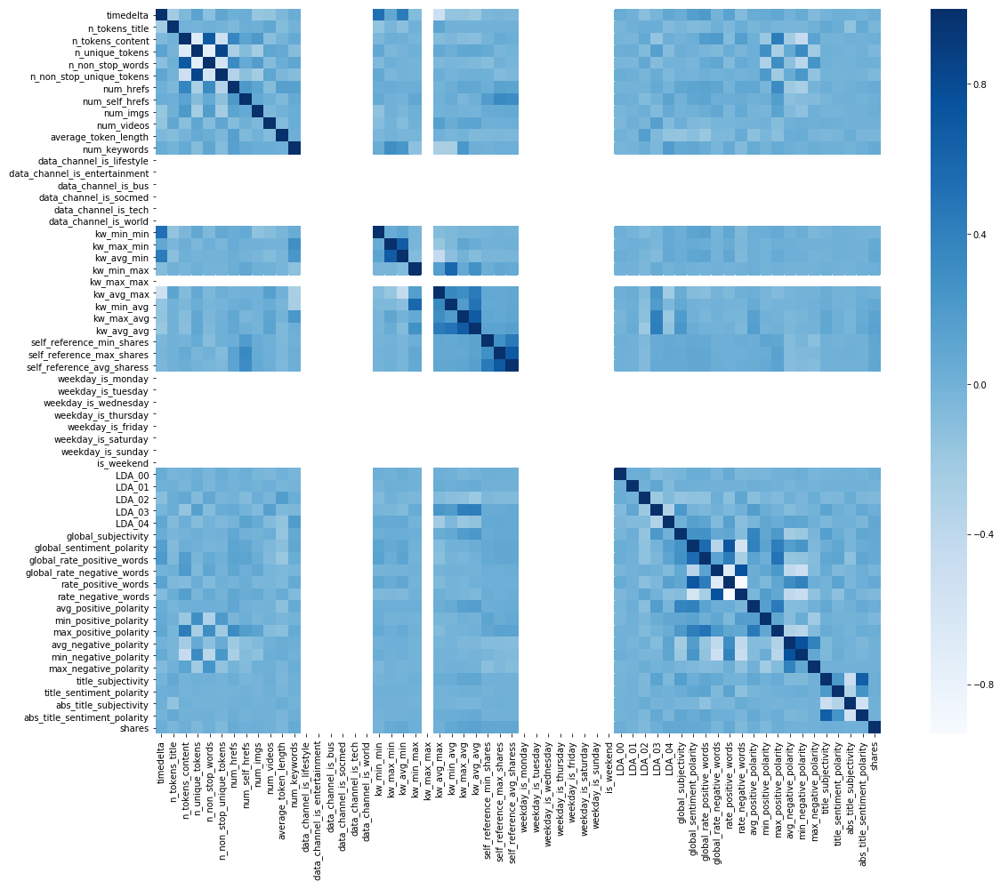

In [129]:
f, ax = plt.subplots(figsize=(20,15))
sns.heatmap(correlation, vmax=1, cmap= 'Blues',square=True,ax=ax);

plt.show()

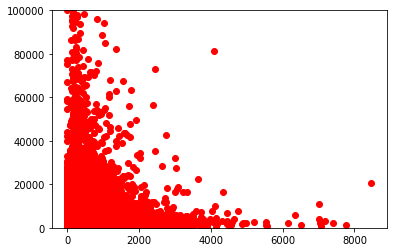

In [10]:
plt.scatter(data['n_tokens_content'], data['shares'],color='r')
plt.ylim(0,100000)
plt.show()